# Importing Libraries

In [1]:
#Importing some importnat libraries
# Necessary utility modules and libraries
import os
import shutil
import pathlib
import random
import datetime
import cv2
import numpy as np    # library for numerical python works
import pandas as pd    # library for data manipulation
import pickle     # library for loading models
from tqdm import tqdm
# Plotting / Visualisation libraries 
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import plotly.graph_objects as go    
import plotly.express as px
from scipy.signal import gaussian, convolve2d
import seaborn as sns

# Libraries for building the model and data preprocessing
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import train_test_split
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import roc_curve,confusion_matrix,precision_score,recall_score,roc_auc_score
import tensorflow as tf
import tensorflow_hub as hub
from tensorflow import keras
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Input, Dense, Conv2D, Flatten, MaxPool2D, Dropout, Activation, GlobalAveragePooling2D, BatchNormalization, GlobalMaxPooling2D
from tensorflow.keras.applications import DenseNet121, ResNet50, InceptionV3, Xception, VGG16
from tensorflow.keras.models import Sequential
from tensorflow.keras import backend
from tensorflow.keras.regularizers import l2, l1
from sklearn.metrics import classification_report, precision_recall_fscore_support, accuracy_score, confusion_matrix

from tensorflow.keras.models import Model

from tensorflow.keras.callbacks import EarlyStopping, CSVLogger, ModelCheckpoint, TensorBoard
from tensorflow.keras.preprocessing import image_dataset_from_directory

from keras.callbacks import ReduceLROnPlateau

from PIL import Image
from tensorflow.keras.layers import Input, Lambda, Dense, Flatten
from tensorflow.keras.models import Model

import warnings
warnings.filterwarnings('ignore')
pd.set_option("display.max_columns",None)   # setting for showing max columns

# Detect TPU, return appropriate distribution strategy
# try:
#     tpu = tf.distribute.cluster_resolver.TPUClusterResolver() 
#     print('Running on TPU ', tpu.master())
# except ValueError:
#     tpu = None

# if tpu:
#     tf.config.experimental_connect_to_cluster(tpu)
#     tf.tpu.experimental.initialize_tpu_system(tpu)
#     strategy = tf.distribute.experimental.TPUStrategy(tpu)
# else:
#     strategy = tf.distribute.get_strategy() 

# print("REPLICAS: ", strategy.num_replicas_in_sync)



REPLICAS:  1


# Data Analysis and Visualisation

In [2]:
classes = ['No_DR', 'Mild', 'Moderate', 'Severe', 'Proliferate_DR']    # differnet classes in dataset
dir_path = '../input/eyepacspreprocess/eyepacs_preprocess/eyepacs_preprocess'   # directory path for images
df = pd.read_csv("../input/eyepacspreprocess/trainLabels.csv")    # directory path for labels

In [3]:
mapping ={
0:'No_DR',
1:'Mild',
2:'Moderate',
3:'Severe',
4:'Proliferate_DR'}

df['Disease_Name'] = df['level'].map(mapping)    # mapping the labels with the respective targets

In [4]:
df    # visualising the data after mapping the labels

,image,level,Disease_Name
0,10_left,0,No_DR
1,10_right,0,No_DR
2,13_left,0,No_DR
3,13_right,0,No_DR
4,15_left,1,Mild
...,...,...,...
35103,44347_right,0,No_DR
35104,44348_left,0,No_DR
35105,44348_right,0,No_DR
35106,44349_left,0,No_DR


In [5]:
counts = df.Disease_Name.value_counts()    # Getting the counts of the different labels
px.pie(df,names=counts.index,values = counts.values,title="Label Visualisation")

In [6]:
data_list = os.listdir(dir_path)     # total images in the data
len(data_list)

35108

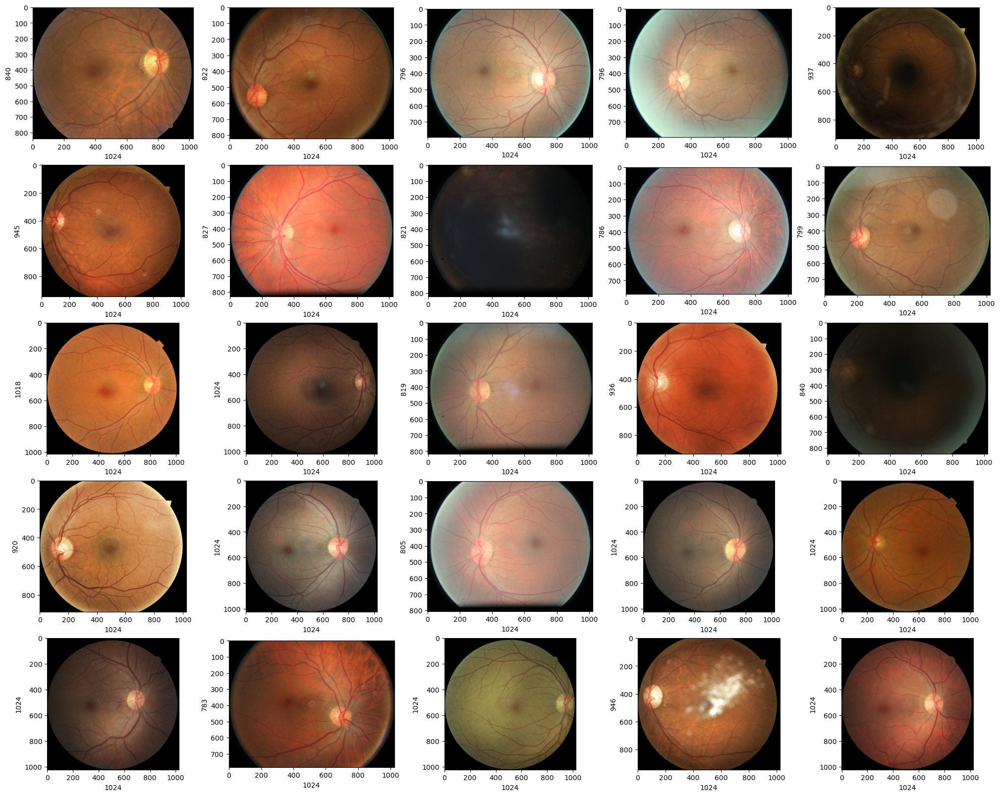

In [7]:
plt.figure(figsize=(25, 20))    # plotting random images from the data
for i in range(1, 26):
    plt.subplot(5, 5, i)
    img_name = random.choice(data_list)
    img_path = os.path.join(dir_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    plt.imshow(img)
    plt.xlabel(img.shape[1])
    plt.ylabel(img.shape[0])

# Data Processing and Image Preprocessing

we will perform two type of filtering:

First: Histogram Equalization

Second: Ben Graham's Processing Method

Explore histogram of a random image

### Plotting color histogram of Random Images

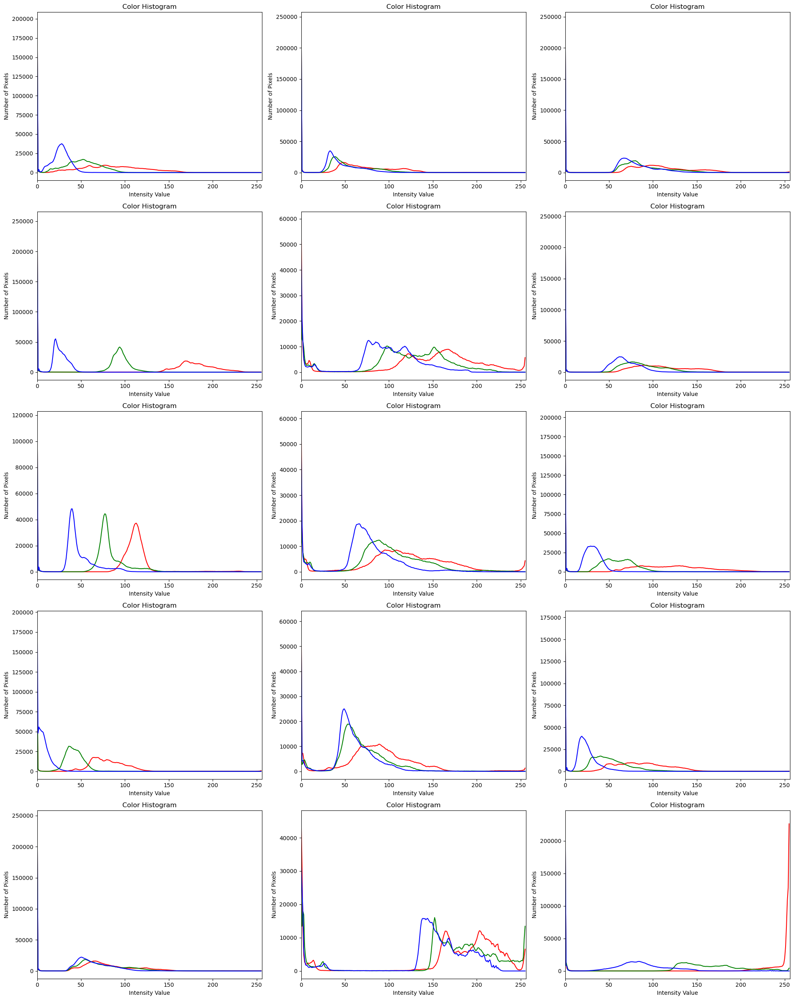

In [8]:
plt.figure(figsize=(20, 25))
for i in range(1, 16):
    plt.subplot(5, 3, i)
    plt.tight_layout()
    plt.title("Color Histogram")
    plt.xlabel("Intensity Value")
    plt.ylabel("Number of Pixels")
    img_name = random.choice(data_list)
    img_path = os.path.join(dir_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    channels = cv2.split(img)
    colors = ['r', 'g', 'b']
    
    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

In [9]:
img_width = 100         
img_height = 100

def read_img(img_name, resize=False):             # function for reading Images
    img_path = os.path.join(dir_path, img_name)
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    
    if resize:
        img = cv2.resize(img, (img_width, img_hight))
    
    return img

def ben_graham(img):    # Function for ben_graham image processing
    img_ben = cv2.addWeighted(img, 4, cv2.GaussianBlur(img, (0, 0), 10), -4, 128)
    return img_ben


def hist_equalization(img):    # Function for histogram equiliztion image processing
    red, green, blue = cv2.split(img)
    hist_red = cv2.equalizeHist(red)
    hist_green = cv2.equalizeHist(green)
    hist_blue = cv2.equalizeHist(blue)
    
    img_eq = cv2.merge((hist_red, hist_green, hist_blue))
    
    return img_eq

Now we'll calculate histogram equility for some images with its label

Taking a copy from the cropped images dataset(list) to apply histogram equalization

In [10]:
equal_hist_images = data_list.copy()
len(equal_hist_images)

35108

### Histogram Equalization

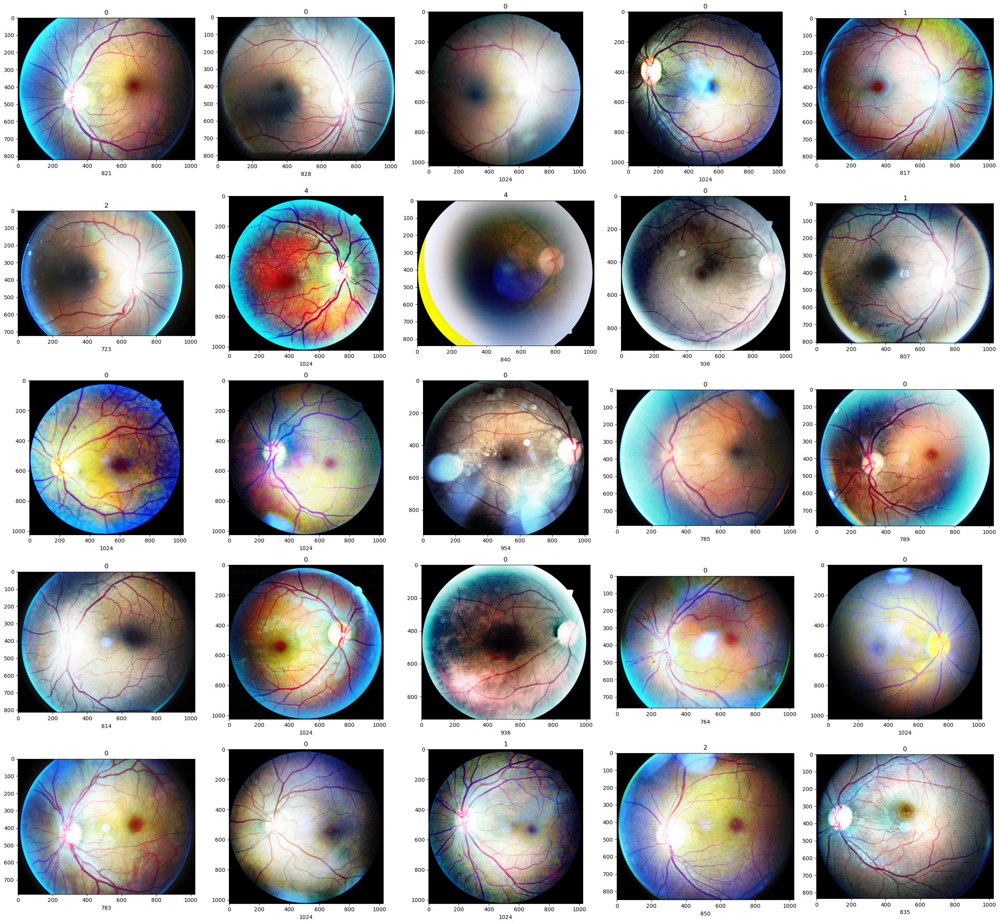

In [11]:
plt.figure(figsize=(26, 24))             # applying histogram equilization to the images
counter = 0
level_cropped_col = df['level']
level_cropped_col
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 5, counter)
    plt.tight_layout()
    # level_cropped_col is the labels, we've created it above
    plt.title(level_cropped_col[counter - 1])
    
    img = read_img(img_name)
    
    # Applying the Histogram Equaliztion
    img_eq = hist_equalization(img)
    
    plt.imshow(img_eq)
    plt.xlabel(img_eq.shape[1])
    plt.xlabel(img_eq.shape[0])
    
    if counter == 25:
        break

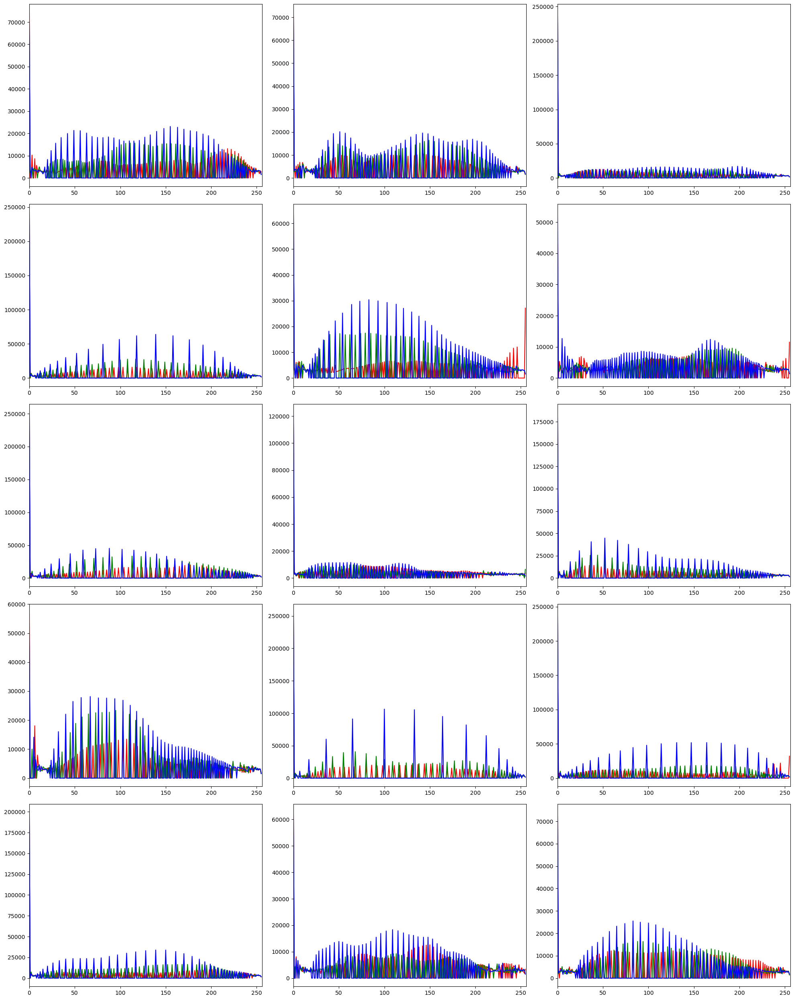

In [12]:
plt.figure(figsize=(20, 25))       # plotting color histogram of images after histogram equilization
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 3, counter)
    plt.tight_layout()
    
    img = read_img(img_name)
    
    # Applying the Histogram Equaliztion
    img_eq = hist_equalization(img)
    
    channels = cv2.split(img_eq)
    colors = ['r', 'g', 'b']
    
    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])
    
    if counter == 15:
        break

Now we'll calculate Ben Graham's processing method for some images with its label

Taking a copy from the cropped images dataset(list) to apply Ben Graham's processing method

### Ben Graham's processing

In [13]:
ben_images = data_list.copy()
len(ben_images)

35108

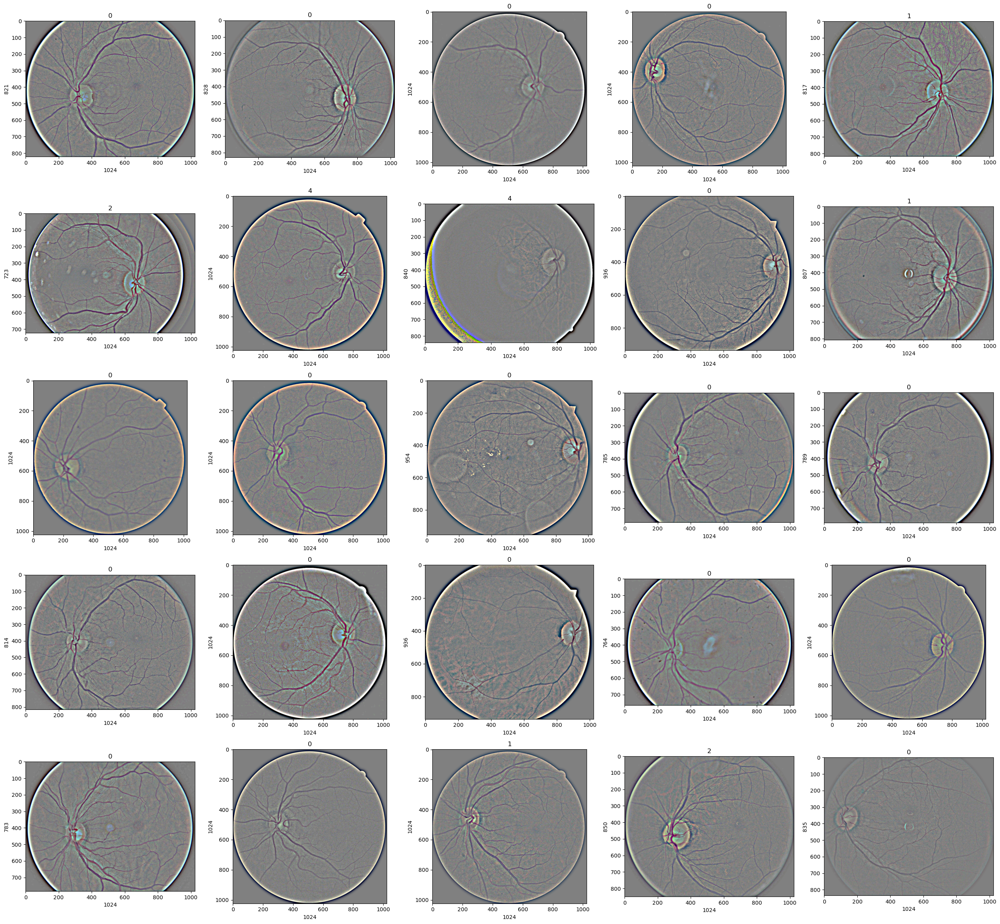

In [14]:
plt.figure(figsize=(26, 24))
counter = 0
for img_name in ben_images:
    counter += 1
    plt.subplot(5, 5, counter)
    plt.tight_layout()
    # level_cropped_col is the lebels list
    plt.title(level_cropped_col[counter - 1])
    
    img = read_img(img_name)
    
    # Applying Ben Graham's Method
    img_ben = ben_graham(img)
    
    plt.imshow(img_ben)
    plt.xlabel(img_ben.shape[1])
    plt.ylabel(img_ben.shape[0])
    
    if counter == 25:
        break


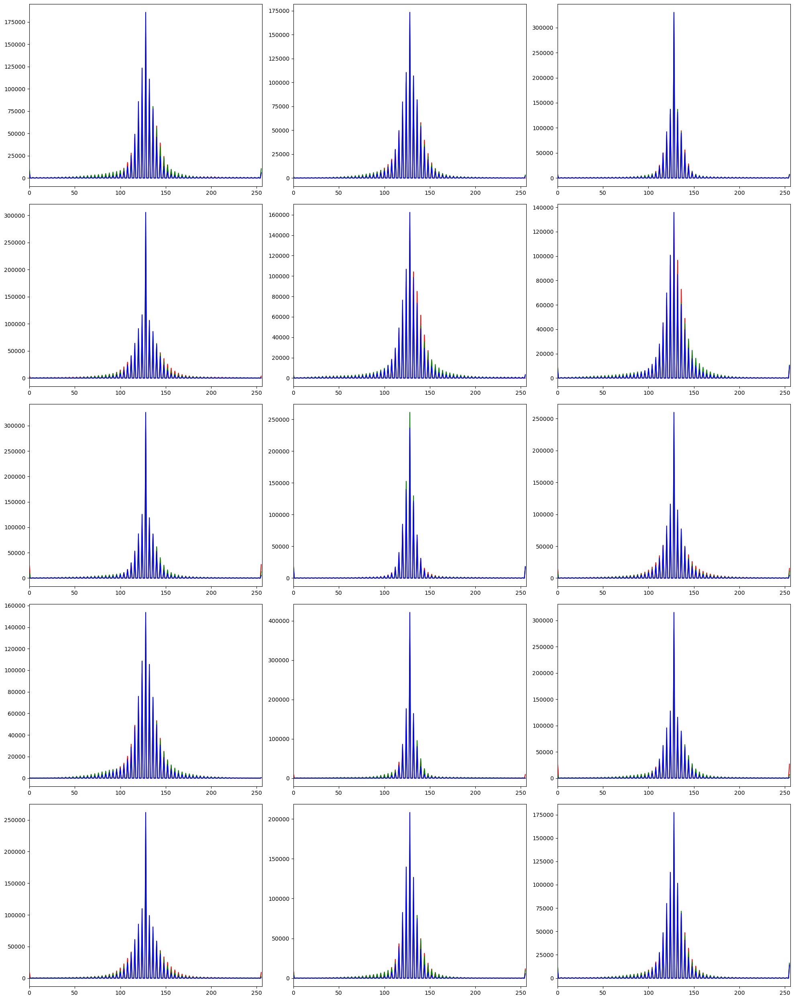

In [15]:
plt.figure(figsize=(20, 25))
counter = 0
for img_name in equal_hist_images:
    counter += 1
    plt.subplot(5, 3, counter)
    plt.tight_layout()
    
    img = read_img(img_name)
    
    # Applying Ben Graham's Method
    img_ben = ben_graham(img)
    
    channels = cv2.split(img_ben)
    colors = ['r', 'g', 'b']
    
    for (channel, color) in zip(channels, colors):
        hist = cv2.calcHist([channel], [0], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])
    
    if counter == 15:
        break

### Loading Dataset

In [16]:
df.head()    # visualising first five rows of the data

,image,level,Disease_Name
0,10_left,0,No_DR
1,10_right,0,No_DR
2,13_left,0,No_DR
3,13_right,0,No_DR
4,15_left,1,Mild


In [17]:
df['image_name'] = [img + '.jpeg' for img in df['image']]
df.head()

,image,level,Disease_Name,image_name
0,10_left,0,No_DR,10_left.jpeg
1,10_right,0,No_DR,10_right.jpeg
2,13_left,0,No_DR,13_left.jpeg
3,13_right,0,No_DR,13_right.jpeg
4,15_left,1,Mild,15_left.jpeg


In [18]:
df['level'].unique()        # getting unique labels from the data

array([0, 1, 2, 4, 3])

In [19]:
train_ds, val_ds = train_test_split(df, test_size=0.2)     # splitting data into train and test parts
train_ds.shape, val_ds.shape

((28086, 4), (7022, 4))

In [20]:
train_ds        # visualising the training data

,image,level,Disease_Name,image_name
27943,35406_right,0,No_DR,35406_right.jpeg
11733,14731_left,2,Moderate,14731_left.jpeg
10016,12633_right,0,No_DR,12633_right.jpeg
15478,19405_left,0,No_DR,19405_left.jpeg
31017,39223_right,0,No_DR,39223_right.jpeg
...,...,...,...,...
1046,1297_right,0,No_DR,1297_right.jpeg
20602,25985_left,4,Proliferate_DR,25985_left.jpeg
29324,37147_left,0,No_DR,37147_left.jpeg
5198,6546_left,1,Mild,6546_left.jpeg


In [21]:
def my_processes(img):            #function for image processing based on ben graham method
    img = cv2.resize(img, (img_width, img_height))
    
    # Apply your image processing method
    img = ben_graham(img)
    
    return img

# Data Augmentation

Applying augmentation to datasets

In [22]:
train_datagen = ImageDataGenerator(rescale = 1./255.,       # initialisng the image datagenerator for training data
                                  rotation_range = 40,
                                  width_shift_range = 0.2,
                                  height_shift_range = 0.2,
                                  shear_range = 0.2,
                                  horizontal_flip = True,
                                  preprocessing_function=  ben_graham)

In [23]:
val_datagen = ImageDataGenerator(rescale = 1./255.)   # initialisng the image datagenerator for validation data

In [24]:
train_ds = train_ds.astype(str)   # chaning dtype of the data into string
train_ds.info()
val_ds = val_ds.astype(str)
val_ds.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28086 entries, 27943 to 4466
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   image         28086 non-null  object
 1   level         28086 non-null  object
 2   Disease_Name  28086 non-null  object
 3   image_name    28086 non-null  object
dtypes: object(4)
memory usage: 1.1+ MB
<class 'pandas.core.frame.DataFrame'>
Int64Index: 7022 entries, 34182 to 13101
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   image         7022 non-null   object
 1   level         7022 non-null   object
 2   Disease_Name  7022 non-null   object
 3   image_name    7022 non-null   object
dtypes: object(4)
memory usage: 274.3+ KB


In [25]:
# Fenerating training and validation data using flow from  dataframe
batch_size = 32    # setting batch size to 32

train_dataset = train_datagen.flow_from_dataframe(train_ds,
                                                 dir_path,
                                                 x_col="image_name",
                                                 y_col="level",
                                                 class_mode='categorical',
                                                 batch_size=batch_size,
                                                 target_size=(120, 120),shuffle = True  )


val_dataset = val_datagen.flow_from_dataframe(val_ds,
                                             dir_path,
                                             x_col='image_name',
                                             y_col='level',
                                             class_mode='categorical',
                                             batch_size=batch_size,
                                             target_size=(120, 120))

Found 28086 validated image filenames belonging to 5 classes.
Found 7022 validated image filenames belonging to 5 classes.


## Model Building,Training and Evalaution on Test data

### Xception Model

In [27]:
input_shape=(120,120,3)   # input shape of image
classes = 5  # classes / labels
epoch = 5   # setting epochs
batch_size = 32   #setting  batch size
xcep = Xception(weights="imagenet", input_shape=(120,120,3), classes=5, include_top=False)   # initialising model
for layer in xcep.layers:
    layer.trainable = False
    
#x = Flatten()(xcep.output)
x = GlobalMaxPooling2D()(xcep.output)
x = Dense(1024, activation='relu')(x)
x = Dense(512, activation='relu')(x)
x = Dropout(0.3)(x)
x = Dense(50, activation = 'relu')(x)
x = Dropout(0.2)(x)
prediction = Dense(5, activation='softmax')(x)
# create a model object
model1 = Model(inputs=xcep.input, outputs=prediction)

# summarize the model
#model1.summary()

model1.compile(loss='categorical_crossentropy',optimizer='adam',metrics= ['accuracy',tf.keras.metrics.Precision(top_k=1),
                                                                               tf.keras.metrics.Recall(top_k=1)])
early_stop= EarlyStopping(monitor='val_loss',patience=2)
learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience=2, verbose=1, factor=0.5, min_lr=1e-8)
history1=model1.fit(train_dataset, epochs=5, batch_size= 32, validation_data=val_dataset,callbacks=[early_stop, learning_rate_reduction])

class_labels = val_dataset.class_indices
class_labels = {v: k for k, v in class_labels.items()}
classes = list(class_labels.values())
Y_pred = model1.predict(val_dataset)   #making prediction on test data
y_pred1 = np.argmax(Y_pred, axis=1)

83683744/83683744 [==============================] - 0s 0us/step
Epoch 1/5
878/878 [==============================] - 952s 1s/step - loss: 0.9357 - accuracy: 0.7267 - precision: 0.7267 - recall: 0.7267 - val_loss: 0.8325 - val_accuracy: 0.7404 - val_precision: 0.7404 - val_recall: 0.7404 - lr: 0.0010
Epoch 2/5
878/878 [==============================] - 699s 797ms/step - loss: 0.8568 - accuracy: 0.7335 - precision: 0.7335 - recall: 0.7335 - val_loss: 0.8179 - val_accuracy: 0.7404 - val_precision: 0.7404 - val_recall: 0.7404 - lr: 0.0010
Epoch 3/5
878/878 [==============================] - 730s 832ms/step - loss: 0.8466 - accuracy: 0.7336 - precision: 0.7336 - recall: 0.7336 - val_loss: 0.8143 - val_accuracy: 0.7405 - val_precision: 0.7405 - val_recall: 0.7405 - lr: 0.0010
Epoch 4/5
878/878 [==============================] - 703s 801ms/step - loss: 0.8372 - accuracy: 0.7338 - precision: 0.7338 - recall: 0.7338 - val_loss: 0.8181 - val_accuracy: 0.7405 - val_precision: 0.7405 - val_recall

In [49]:
accuracy1=accuracy_score(val_dataset.classes,y_pred1)  # getting accuracy score
precision1 = precision_score(val_dataset.classes, y_pred1, average = 'weighted')   # getting precision score
recall1 = recall_score(val_dataset.classes, y_pred1, average = 'weighted')    # getting recall score
f1_score1 = f1_score(val_dataset.classes, y_pred1, average = 'weighted')    # getting f1 score score
print("Precision: %s, Recall: %s, f1_score: %s, accuracy: %s" %(precision1, recall1, f1_score1, accuracy1))

Precision: 0.548118672207251, Recall: 0.7401025348903446, f1_score: 0.629804906930993, accuracy: 0.7401025348903446


### Custom CNN Model

In [28]:
# Defining Custom Layers
custom_model = tf.keras.models.Sequential()
# LAyer 1
custom_model.add(tf.keras.layers.Conv2D(64, (3, 3), padding='same', input_shape=(120,120,3), activation='relu'))
custom_model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
custom_model.add(tf.keras.layers.BatchNormalization())
#Layer 2
custom_model.add(tf.keras.layers.Conv2D(128, (3, 3), padding='same',activation='relu'))
custom_model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
custom_model.add(tf.keras.layers.BatchNormalization())

#Layer 3
custom_model.add(tf.keras.layers.Conv2D(250, (3, 3), padding='same',activation='relu'))
custom_model.add(tf.keras.layers.MaxPooling2D(pool_size=(2, 2)))
# Nural network layers
custom_model.add(tf.keras.layers.Flatten())

custom_model.add(tf.keras.layers.Dense(128, activation='relu'))
custom_model.add(tf.keras.layers.Dropout(0.3))
custom_model.add(tf.keras.layers.BatchNormalization())
custom_model.add(tf.keras.layers.Dense(100, activation='relu'))
custom_model.add(tf.keras.layers.Dense(5, activation='softmax'))

In [29]:
# Training custom model
custom_model.compile(optimizer="adam",loss="categorical_crossentropy",metrics=["accuracy",tf.keras.metrics.Precision(top_k=1),
                                                                               tf.keras.metrics.Recall(top_k=1)])
history2= custom_model.fit(train_dataset,batch_size = 32,validation_data=val_dataset,epochs=5)

Epoch 1/5
878/878 [==============================] - 719s 812ms/step - loss: 0.9195 - accuracy: 0.7251 - precision_1: 0.7251 - recall_1: 0.7251 - val_loss: 0.8612 - val_accuracy: 0.7404 - val_precision_1: 0.7404 - val_recall_1: 0.7404
Epoch 2/5
878/878 [==============================] - 684s 779ms/step - loss: 0.8805 - accuracy: 0.7336 - precision_1: 0.7336 - recall_1: 0.7336 - val_loss: 0.8620 - val_accuracy: 0.7404 - val_precision_1: 0.7404 - val_recall_1: 0.7404
Epoch 3/5
878/878 [==============================] - 677s 771ms/step - loss: 0.8716 - accuracy: 0.7336 - precision_1: 0.7336 - recall_1: 0.7336 - val_loss: 1.5262 - val_accuracy: 0.7404 - val_precision_1: 0.7404 - val_recall_1: 0.7404
Epoch 4/5
878/878 [==============================] - 678s 773ms/step - loss: 0.8657 - accuracy: 0.7336 - precision_1: 0.7336 - recall_1: 0.7336 - val_loss: 0.8480 - val_accuracy: 0.7404 - val_precision_1: 0.7404 - val_recall_1: 0.7404
Epoch 5/5
878/878 [==============================] - 680s 77

In [52]:
class_labels = val_dataset.class_indices
class_labels = {v: k for k, v in class_labels.items()}
classes = list(class_labels.values())
Y_pred = custom_model.predict(val_dataset)   #making prediction on test data
y_pred2 = np.argmax(Y_pred, axis=1)

220/220 [==============================] - 111s 502ms/step


In [53]:
accuracy2=accuracy_score(val_dataset.classes,y_pred2)    # getting accuracy score
precision2 = precision_score(val_dataset.classes, y_pred2, average = 'weighted')   # getting precision score
recall2 = recall_score(val_dataset.classes, y_pred2, average = 'weighted')   # getting recall score
f1_score2 = f1_score(val_dataset.classes, y_pred2, average = 'weighted')    # getting f1 score score
print("Precision: %s, Recall: %s, f1_score: %s, accuracy: %s" %(precision2, recall2, f1_score2, accuracy2))

Precision: 0.5481734340078271, Recall: 0.7403873540301908, f1_score: 0.6299441704611671, accuracy: 0.7403873540301908


### Ensemble Deep CNN Model

In [30]:
# Example of creating a CNN model with a VGG block
from keras.models import Model
from keras.layers import Input
from keras.layers import Conv2D, Flatten, Dense, Dropout
from keras.layers import MaxPooling2D
from tensorflow.keras.utils import plot_model
from keras.layers import concatenate

# function for creating a vgg block
def vgg_block(layer_in, n_filters, n_conv):
	# add convolutional layers
	for _ in range(n_conv):
		layer_in = Conv2D(n_filters, (3,3), padding='same', activation='relu')(layer_in)
	# add max pooling layer
	layer_in = MaxPooling2D((2,2), strides=(2,2))(layer_in)
	return layer_in



# function for creating a projected inception module
def inception_module(layer_in, f1, f2_in, f2_out, f3_in, f3_out, f4_out):
	# 1x1 conv
	conv1 = Conv2D(f1, (1,1), padding='same', activation='relu')(layer_in)
	# 3x3 conv
	conv3 = Conv2D(f2_in, (1,1), padding='same', activation='relu')(layer_in)
	conv3 = Conv2D(f2_out, (3,3), padding='same', activation='relu')(conv3)
	# 5x5 conv
	conv5 = Conv2D(f3_in, (1,1), padding='same', activation='relu')(layer_in)
	conv5 = Conv2D(f3_out, (5,5), padding='same', activation='relu')(conv5)
	# 3x3 max pooling
	pool = MaxPooling2D((3,3), strides=(1,1), padding='same')(layer_in)
	pool = Conv2D(f4_out, (1,1), padding='same', activation='relu')(pool)
	# concatenate filters, assumes filters/channels last
	layer_out = concatenate([conv1, conv3, conv5, pool], axis=-1)
	return layer_out

# define model input
visible = Input(shape=(120, 120, 3))
# add vgg module
layer = vgg_block(visible, 64, 2)
#layer = vgg_block(layer, 64, 2)
# add inception block 1
layer = inception_module(layer, 64, 96, 128, 16, 32, 32)
#add vgg module
layer = vgg_block(layer, 32, 2)
# add vgg module
layer = vgg_block(layer, 16, 2)

# create model
layer= Flatten()(layer)
fc=Dense(512, activation="relu")(layer)
fc=Dense(216, activation="relu")(fc)
fc= Dropout(0.3)(fc)
prediction=Dense(5, activation="softmax")(fc)
model_custom = Model(inputs=visible, outputs= prediction)

# summarize model
model_custom.summary()
# plot model architecture
plot_model(model_custom, show_shapes=True, to_file='vgg_block.png')



# # create a model object
# model1 = Model(inputs=vgg16.input, outputs=prediction)

# # summarize the model
# #model1.summary()

model_custom.compile(loss='categorical_crossentropy',optimizer='RMSprop',metrics= ['accuracy',tf.keras.metrics.Precision(top_k=1),
                                                                               tf.keras.metrics.Recall(top_k=1)])
early_stop= EarlyStopping(monitor='val_loss',patience=5)

learning_rate_reduction = ReduceLROnPlateau(monitor='val_accuracy', patience=1, verbose=1, factor=0.5, min_lr=1e-8)
history3=model_custom.fit(train_dataset, epochs=5, batch_size=216, validation_data=val_dataset,
          callbacks=[early_stop, learning_rate_reduction])

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 120, 120, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_7 (Conv2D)              (None, 120, 120, 64  1792        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_8 (Conv2D)              (None, 120, 120, 64  36928       ['conv2d_7[0][0]']               
                                )                                                           

In [54]:
class_labels = val_dataset.class_indices
class_labels = {v: k for k, v in class_labels.items()}
classes = list(class_labels.values())
Y_pred = model_custom.predict(val_dataset)   #making prediction on test data
y_pred3 = np.argmax(Y_pred, axis=1)

220/220 [==============================] - 112s 509ms/step


In [55]:
accuracy3=accuracy_score(val_dataset.classes,y_pred3)   # getting accuracy score
precision3 = precision_score(val_dataset.classes, y_pred3, average = 'weighted')    # getting precision score
recall3 = recall_score(val_dataset.classes, y_pred3, average = 'weighted')   # getting recall score
f1_score3 = f1_score(val_dataset.classes, y_pred3, average = 'weighted')   # getting f1 score
print("Precision: %s, Recall: %s, f1_score: %s, accuracy: %s" %(precision3, recall3, f1_score3, accuracy3))

Precision: 0.5481734340078271, Recall: 0.7403873540301908, f1_score: 0.6299441704611671, accuracy: 0.7403873540301908


## Models Comparison

In [56]:
data = {'Precision':[precision1,precision2,precision3], # creating data contains metrics of evaluation
        'Recall':[recall1,recall2,recall3],
        'Accuracy':[accuracy1,accuracy2,accuracy3],
        'F1_score':[f1_score1,f1_score2,f1_score3],
        'Algo':['Xception','Custom_Model','Ensemble_Model'] }
df = pd.DataFrame(data)        # making dataframe of data

In [57]:
df     # visualising data

,Precision,Recall,Accuracy,F1_score,Algo
0,0.548119,0.740103,0.740103,0.629805,Xception
1,0.548173,0.740387,0.740387,0.629944,Custom_Model
2,0.548173,0.740387,0.740387,0.629944,Ensemble_Model


In [73]:
# plotting bar plot to comapre applied models based on Accuracy
fig = go.Figure(data=[go.Bar(
    x=data['Algo'],
    y=data['Accuracy'],
    marker_color=['crimson','blue',' mediumvioletred'],
    width=[0.5, 0.5, 0.5], text=data['Accuracy'], textposition='auto'
)])

fig.update_layout(title_text="Accuracy Comparison", template = 'ggplot2')

fig.update_traces(texttemplate='%{text:0.6p}',textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()


In [74]:
import plotly.express as px                             # plotting bar plot to comapre applied models based on precision
import plotly.offline as pyo


import plotly.graph_objects as go

fig = go.Figure(data=[go.Bar(
    x=data['Algo'],
    y=data['Precision'],
    marker_color=['crimson','blue',' mediumvioletred'],
    width=[0.5, 0.5, 0.5], text=data['Precision'], textposition='auto'
)])
fig.update_layout(title_text="Precision Comparison", template = 'ggplot2')
fig.update_traces(texttemplate='%{text:0.6f}',textposition='inside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')

fig.show()

In [75]:
# plotting bar plot to comapre applied models based on recall
fig = go.Figure(data=[go.Bar(
    x=data['Algo'],
    y=data['Recall'],
    marker_color=['crimson','blue',' mediumvioletred'],
    width=[0.5, 0.5, 0.5], text=data['Recall'], textposition='auto'
)])

fig.update_layout(title_text="Recall Comparison", template = 'ggplot2')

fig.update_traces(texttemplate='%{text:0.6f}',textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

In [77]:
# plotting bar plot to comapre applied models based on F1-score
fig = go.Figure(data=[go.Bar(
    x=data['Algo'],
    y=data['F1_score'],
    marker_color=['crimson','blue',' mediumvioletred'],
    width=[0.5, 0.5, 0.5], text=data['F1_score'], textposition='auto'
)])

fig.update_layout(title_text="F1-score Comparison", template = 'ggplot2')

fig.update_traces(texttemplate='%{text:0.6f}',textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()